In [1]:
%matplotlib inline
import matplotlib.pyplot as plt # 2D plotting library (www.matplotlib.org)
import numpy as np # library for efficient numerical computing with arrays (www.numpy.org)
import pygimli as pg # *G*eophysical *I*nversion and *M*odeling *Li*brary (www.pygimli.org)
import pygimli.meshtools as mt
import pygimli.physics.ert as ert
from pygimli.physics import ERTManager
import pygimli.physics.petro as pet

# Calculations and values

## world dimensions: 
x-direction [m]: 0 - 34  
y-direction [m]: -3 - 20  

## hydraulic potential:
solve Darcy with Finite Elements for hydraulic head distribution [m]:  
$$\nabla \cdot (K \nabla h) = 0$$  
h1 [m] = 16\
h2 [m] = 10\
h3 [m] = 2\
h4 [m] = -1

boundary conditions (Dirichlet):\
left upper gravel layer: h1, right upper gravel layer: h2\
left lower gravel layer: h3, right lower gravel layer: h4

hydraulic conductivity K [m/s]:  
upper and lower sandstone layer (markers 1 & 3): $2 \cdot 10^{-7}$  
upper and lower gravel aquifers (markers 2 & 4): $10^{-3}$  
limestone, dolomite rock (marker 5): $10^{-7}$  
clean sand body (marker 6): $8 \cdot 10^{-3}$

velocity v [m/s]: $\textbf{v} = \frac{-K \nabla h} {\phi}$  
$\textbf{v}_{abs} = \sqrt{\textbf{v}_x^2 + \textbf{v}_y^2}$  
porosity $\phi$ = 0.3  
## streaming potential:
solve streaming potential equation with Finite Elements for streaming potential $\varphi$ [V]:  
$$\nabla \cdot (\sigma \nabla \varphi) = \nabla \cdot (L \textbf{v})$$  
L = 10  

$\varphi1$ [V] = 0<br>
$\varphi2$ [V] = 0.01<br>
$\varphi3$ [V] = 0.1<br>
boundary conditions (Dirichlet):<br>
upper left gravel layer: $\varphi1$<br>
upper right gravel layer: $\varphi3$<br>
limestone, dolomite rock: $\varphi3$<br>

electrical conductivity $\sigma$ [S/m]:<br>
upper sandstone layer: $7 \cdot 10^{-4}$<br> 
upper gravel layer: $9 \cdot 10^{-4}$<br>
lower sandstone layer: $10^{-4}$<br>
lower gravel layer: $4 \cdot 10^{-4}$<br> 
limestone, dolomite rock: $3 \cdot 10^{-1}$<br>
clean sand body: $3 \cdot 10^{-1}$<br>
## tracer transport:
solve transport equation with Finite Volume for concentration c [g/l]:  
$$\frac{\partial c}{\partial t} = \underbrace{\nabla\cdot(D \nabla c)}_{\text{Diffusion / Dispersion}} - \underbrace{\mathbf{v}\nabla c}_{\text{Advection}} + S$$
2 tracer injection positions S[x,y]: <br>
position1 = [2,16] <br>
position2 = [5,0]   <br>
injection load 1 [mg/l]: 5<br>
injection load 2 [mg/l]: 12.5<br>
dispersion rate D [m/s]: D = $\alpha \cdot \textbf{v}_{abs}$  
$\alpha = 10^{-3}$  
##### timestepping:
steps: 5000  
timeperiod [days] = 5  
intervall $\Delta t$ = timeperiod[sec]/(steps-1) = 86.417 sec  
injections stopped after: steps/2  
#### CFL criterion:  
$\Delta x$ = 0.11809 m <br>
$v_{max}$ = 0.00127 m/s  <br>
cfl-criterion = $\frac{v_{max} \Delta t} {\Delta x}$ = 0.9312  <br>
## electrical conductivity:
$\sigma_0$ [S/m] = 0.01  
$\sigma_W =$ 0.1$ c + \sigma_0$ 
## electrical resitivity tomography (ERT):
Archie's equation for $\rho_b$ [$\Omega m$]:  
$$\rho_b = a \cdot (1/\sigma_W)\cdot\phi^{-m}\cdot S^{-n}$$ 
a=1  
m=2  
S=1  
n=2  
measurement array: dipole-dipole<br>
from 0 - 34m<br>
dx = 1.0m<br>

# Create world with geometry

(<AxesSubplot:>, None)

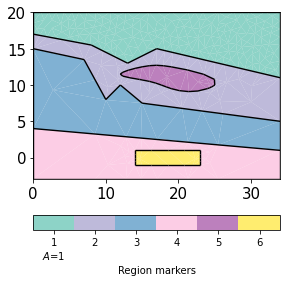

In [3]:
layer1 = mt.createPolygon([[0.0, 20], [34, 20], [34, 11], [17, 15], [13, 13], [8, 15.5], [0.0, 17]],
                          isClosed=True, boundaryMarker=[10,9,11,11,11,11,1], marker = 1,area=1)
layer2 = mt.createPolygon([[0.0, 17], [8,15.5], [13, 13], [17,15], [34, 11], [34, 5], [15, 7.5], [12, 10], 
                           [10, 8], [7, 13.5], [0, 15]],
                          isClosed=True, boundaryMarker=[11,11,11,11,8,12,12,12,12,12,2], marker = 2)
layer3 = mt.createPolygon([[0.0, 15], [7, 13.5], [10, 8], [12, 10], [15, 7.5], [34, 5], [34, 1], [0, 4]],
                          isClosed=True, boundaryMarker=[12,12,12,12,12,7,13,3], marker = 3)
layer4 = mt.createPolygon([[0, 4], [34, 1], [34, -3], [0, -3]],
                          isClosed=True, boundaryMarker=[13,6,5,4], marker = 4)
rock = mt.createPolygon([(12,11.5), (15,12.5), (19,12.5), (25,10),
                         (24,9.5), (19,9.5), (16,10.5)], isClosed=True,
                         addNodes=3, interpolate='spline', boundaryMarker=15, marker = 5)
rock2 = mt.createPolygon([(14,1), (23,1), (23,-1), (14,-1)], isClosed=True,
                         addNodes=3, boundaryMarker=16, marker = 6)
geometry = mt.mergePLC([layer1, layer2, layer3, layer4, rock, rock2])
#plotting:
fig,ax = plt.subplots()
#figsize=(17, 11.5)
ax.tick_params(labelsize=15)
pg.show(geometry, ax=ax, boundaryMarker=True)

## Quality test

(<AxesSubplot:>, None)

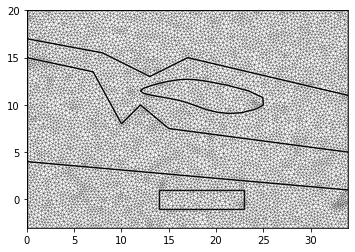

In [3]:
mesh = mt.createMesh(geometry, quality=33.4, markers = True, area=0.1, smooth = [1,10])
pg.show(mesh)

C:\Users\michi\Anaconda3\envs\pg\lib\site-packages\pygimli\viewer\mpl\colorbar.py:434: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  mappable.get_cmap().set_bad([1.0, 1.0, 1.0, 0.0])


(<AxesSubplot:>, <matplotlib.colorbar.Colorbar at 0x121de6d95c8>)

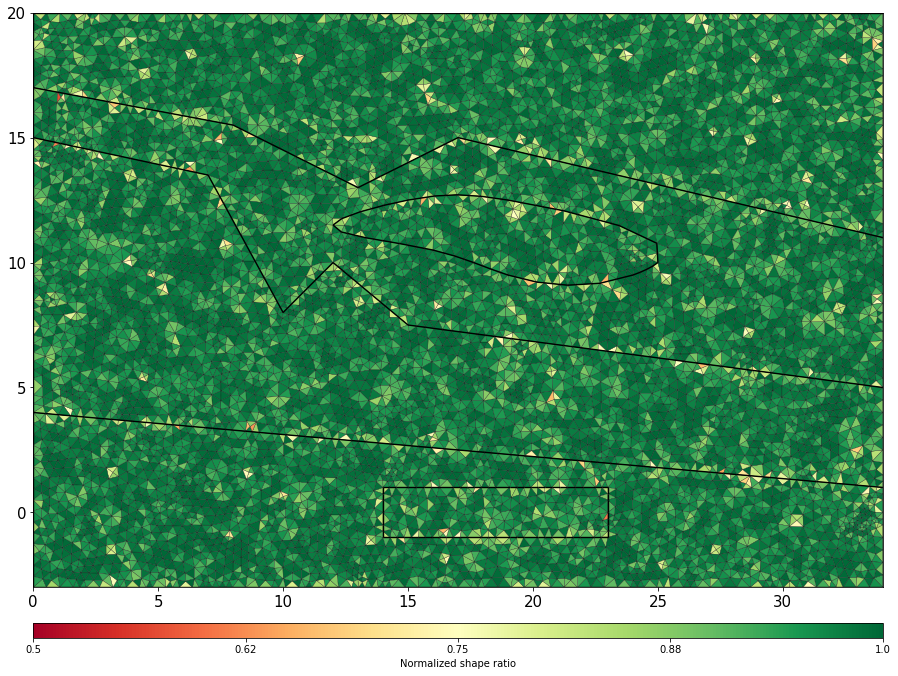

In [4]:
qual = mt.quality(mesh, "nsr")
fig,ax = plt.subplots(1,1,figsize=(17, 11.5))
ax.tick_params(labelsize=15)
pg.show(mesh, qual, ax=ax, cMap="RdYlGn", showMesh=True, hold=True, cMin=0.5, cMax=1.0, label="Normalized shape ratio", labelsize = 15)

# 1. hydraulic potential

(<AxesSubplot:>, <matplotlib.colorbar.Colorbar at 0x121e02a5cc8>)

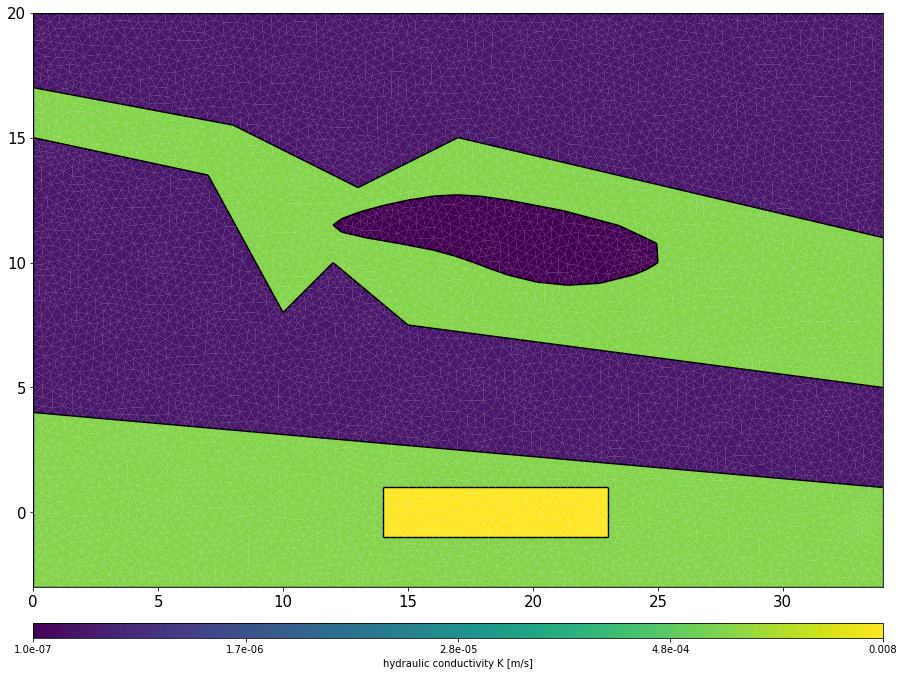

In [5]:
#hydraulic potentials h:
kMap = [[1, 2e-7], [2, 1e-3], [3, 2e-7], [4, 1e-3], [5, 1e-7], [6, 8e-3]] #m/s
h1 = 16 #m
h2 = 10 #m
h3 = 2 #m
h4 = -1 #m
bc = {"Dirichlet": {2: h1, 4: h3, 6: h4, 8: h2}}
#hydraulic conductivity K:
K = pg.solver.parseMapToCellArray(kMap, mesh)
K = np.array(K)
fig,ax = plt.subplots(1,1,figsize=(17, 11.5))
ax.tick_params(labelsize=15)
pg.show(mesh, K , ax=ax, label="hydraulic conductivity K [m/s]", logScale=True, grid=True)

C:\Users\michi\Anaconda3\envs\pg\lib\site-packages\pygimli\viewer\mpl\colorbar.py:264: MatplotlibDeprecationWarning: 
The ax attribute was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  if hasattr(gci, 'ax'):
C:\Users\michi\Anaconda3\envs\pg\lib\site-packages\pygimli\viewer\mpl\colorbar.py:265: MatplotlibDeprecationWarning: 
The ax attribute was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  ax = gci.ax


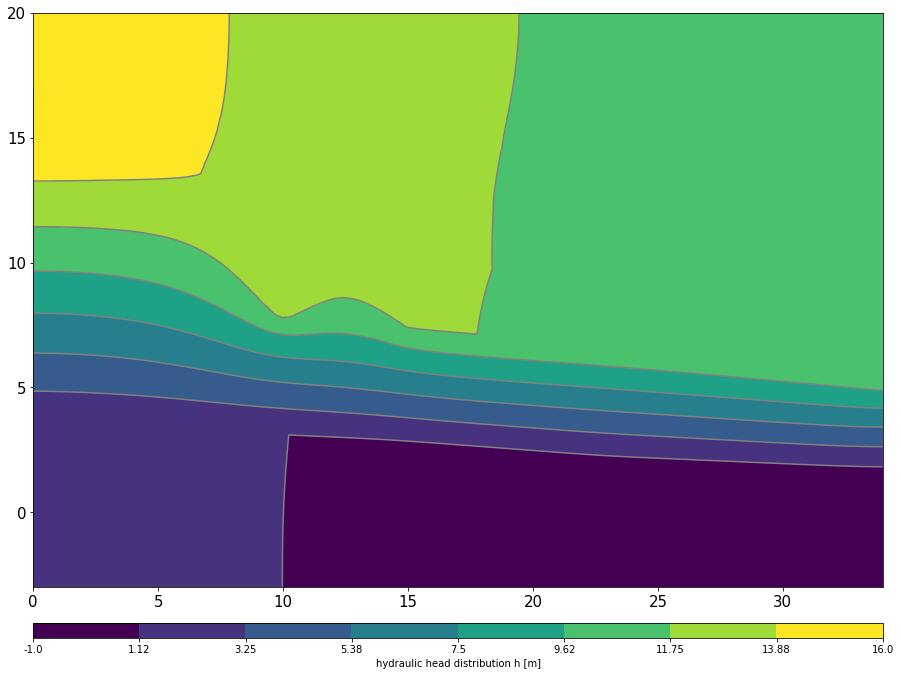

In [6]:
from Darcy import solveDarcy
h = solveDarcy(mesh, K, bc)

In [7]:
from pygimli.viewer.pv import drawStreamLines, drawSlice

In [8]:
por = 0.3
grad_h = pg.solver.grad(mesh, h)
v = ((-K*grad_h.T).T)/por #m/s
v_x = v[:,0] #m/s
v_y = v[:,1] #m/s
v_z = v[:,2] #m/s
v_abs = abs(np.sqrt((v_x**2+v_y**2))) #m/s

C:\Users\michi\Anaconda3\envs\pg\lib\site-packages\pygimli\viewer\mpl\colorbar.py:434: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  mappable.get_cmap().set_bad([1.0, 1.0, 1.0, 0.0])


(<AxesSubplot:>, None)

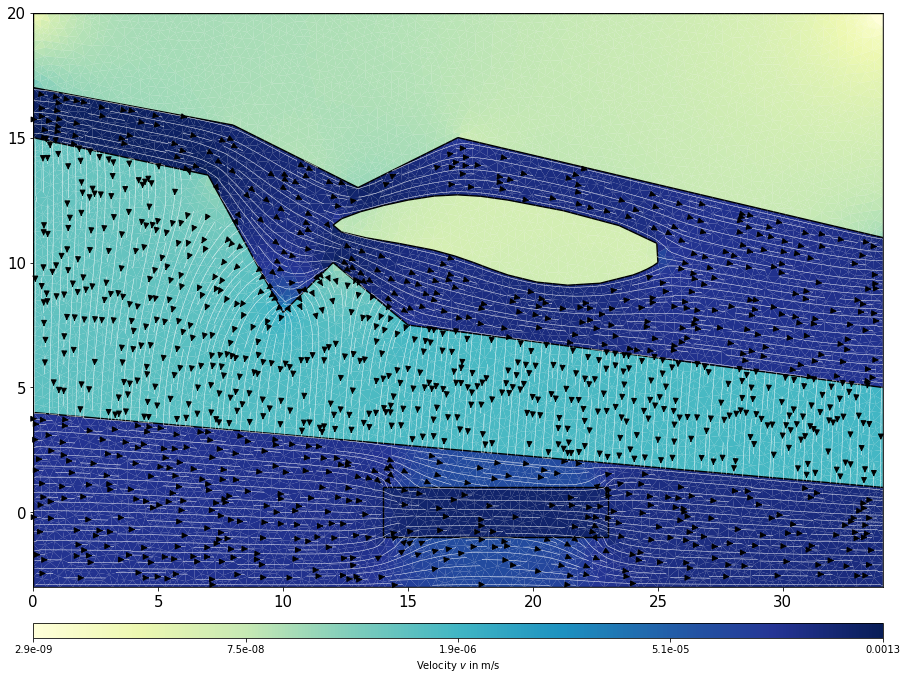

In [10]:
#plotting:
fig, axes = plt.subplots(figsize =(17, 11.5))
ax, _ = pg.show(mesh, data= v_abs, logScale = True, ax=axes, cMap='YlGnBu',
                label= "Velocity $v$ in m$/$s", hold=True)
ax.tick_params(labelsize = 15)
pg.show(mesh, v, ax=ax, color = 'w', linewidth = 0.5, dropTol=5e-7)

# 2. streaming potential

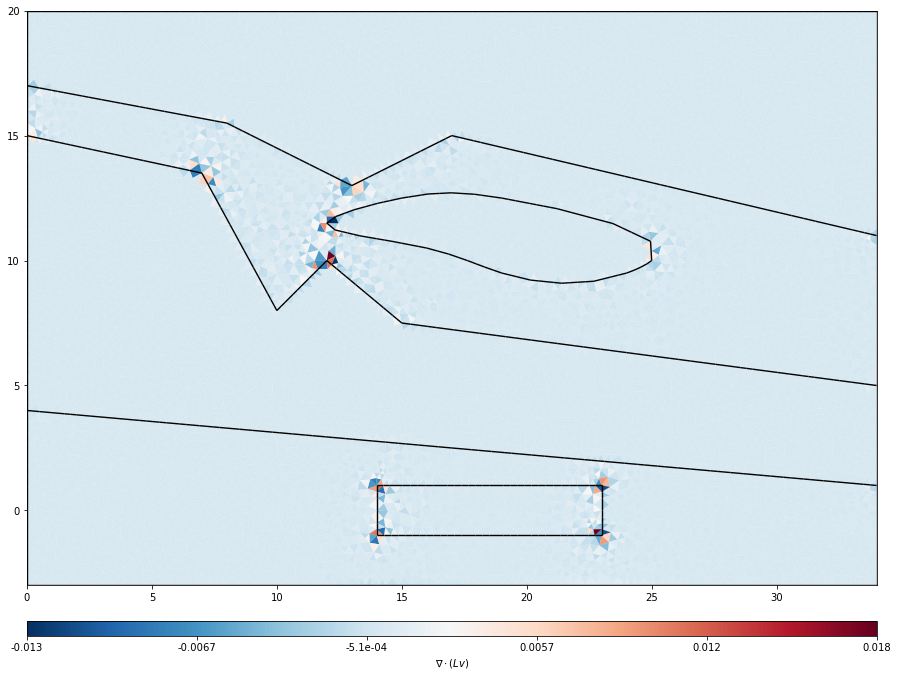

In [11]:
L = 10
rhs = pg.solver.div(mesh, L*v) #right hand side of the streaming potential

fig, axes = plt.subplots(figsize =(17, 11.5))
ax, _ = pg.show(mesh, rhs, ax=axes, cMap='RdBu_r',
                label= r"$\nabla \cdot (Lv)$", hold=True, nLevs = 6)

(<AxesSubplot:xlabel='$\\nabla \\cdot (\\nabla h)$'>,
 <matplotlib.colorbar.Colorbar at 0x1f4bc61da08>)

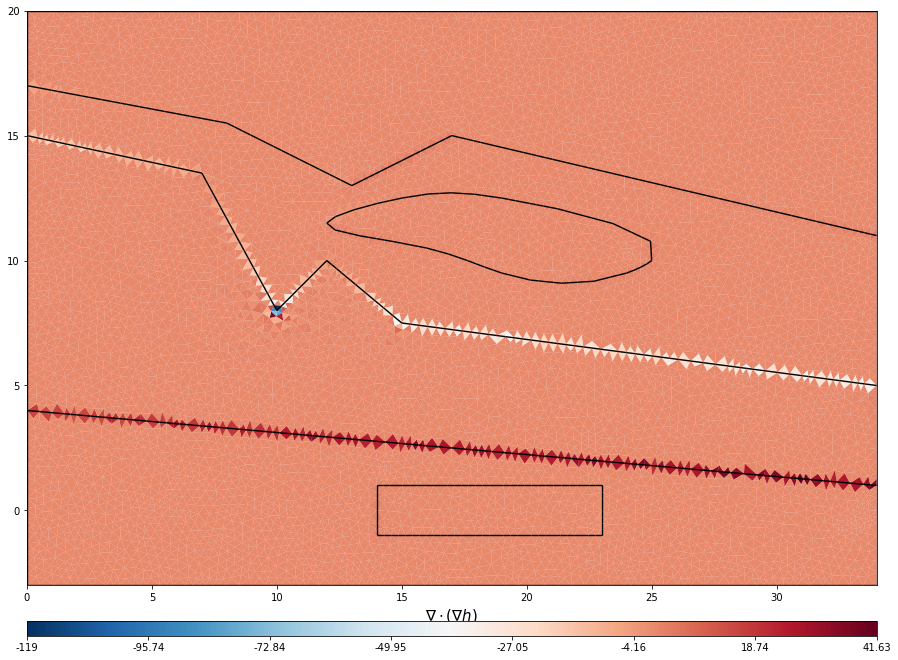

In [10]:
lhs = pg.solver.div(mesh, grad_h/por) #left hand side of the streaming potential
fig, ax = plt.subplots(figsize =(17,11.5))
ax.set_xlabel(r"$\nabla \cdot (\nabla h)$", fontsize="15")
pg.show(mesh, lhs, ax=ax, hold = True, nLevs = 8, cMap = "RdBu_r")

(<AxesSubplot:>, <matplotlib.colorbar.Colorbar at 0x121eebe6dc8>)

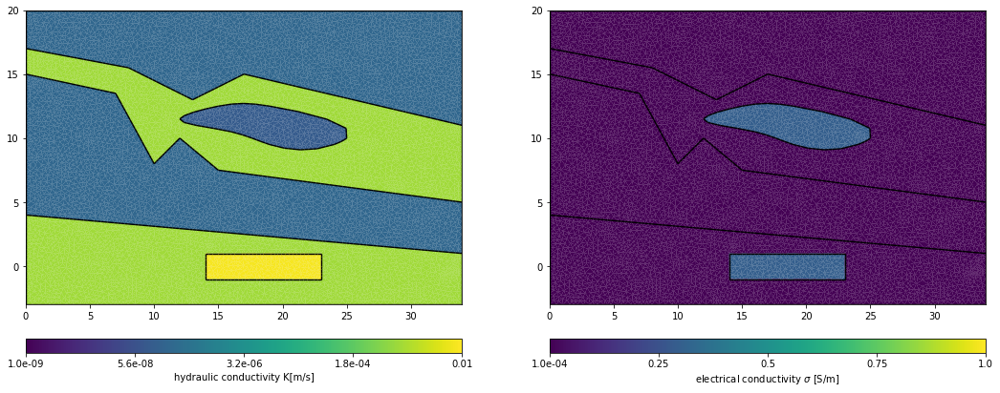

In [12]:
#streaming potentials:
phi1 = 0 #V
phi2 = 0.01 #V
phi3 = 0.1 #V
bc_lhs = {"Dirichlet": {2: phi1, 8: phi3, 15: phi2}}

#electrical conductivity sigma:
sigma = pg.solver.parseMapToCellArray([[1,7e-4],[2,9e-4],[3,1e-4],[4,4e-4],[5,3e-1],[6,3e-1]], mesh)
sigma = np.array(sigma)
fig,ax = plt.subplots(1,2,figsize=(18, 9))
pg.show(mesh, K , cMin=1e-9, cMax=0.01, logScale = True, ax=ax[0],hold=True, label="hydraulic conductivity K[m/s]")
pg.show(mesh, sigma, cMin=0.0001, cMax=1, ax=ax[1], hold=True, label=r"electrical conductivity " r"$\sigma$ [S/m]")

C:\Users\michi\Anaconda3\envs\pg\lib\site-packages\pygimli\viewer\mpl\colorbar.py:264: MatplotlibDeprecationWarning: 
The ax attribute was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  if hasattr(gci, 'ax'):
C:\Users\michi\Anaconda3\envs\pg\lib\site-packages\pygimli\viewer\mpl\colorbar.py:265: MatplotlibDeprecationWarning: 
The ax attribute was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  ax = gci.ax


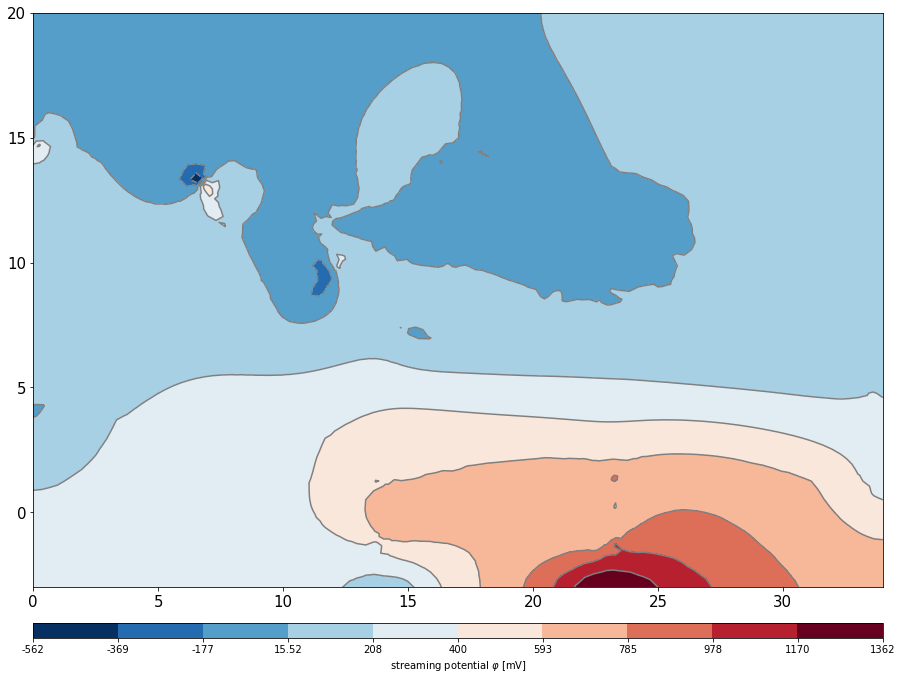

In [13]:
from StreamPotential import solveStreampot
phi,E = solveStreampot(mesh, sigma, bc_lhs, rhs)

Text(0.5, 0, 'x')

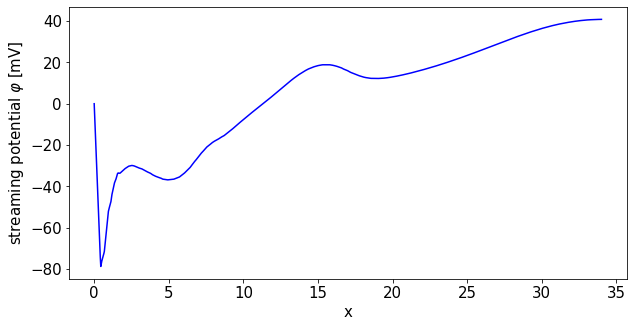

In [14]:
depth = 3
phi = np.array(phi)
x = np.linspace(mesh.xmin(),mesh.xmax(),1000)
x2 = [[i,mesh.ymax()-depth] for i in x]
phi_x = pg.interpolate(mesh,phi,x2)
fig, ax = plt.subplots(figsize =(10,5))
ax.tick_params(labelsize = 15)
ax.plot(x, phi_x*1000,"b")
ax.set_ylabel(r"streaming potential " r"$\varphi$ [mV]",fontsize="15")
ax.set_xlabel('x',fontsize="15")

# 3. tracer transport

number of cells in the mesh: 13984


C:\Users\michi\Anaconda3\envs\pg\lib\site-packages\pygimli\viewer\mpl\colorbar.py:434: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  mappable.get_cmap().set_bad([1.0, 1.0, 1.0, 0.0])


(<AxesSubplot:>, <matplotlib.colorbar.Colorbar at 0x121f137a648>)

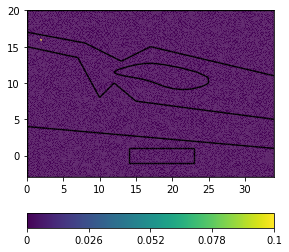

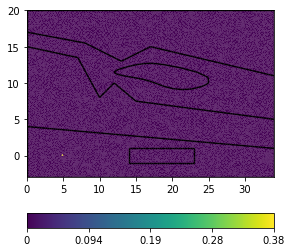

In [15]:
S1 = np.zeros(mesh.cellCount()) #array with all mesh cells
S2 = np.zeros(mesh.cellCount())
print('number of cells in the mesh:',mesh.cellCount())

inj_pos1 = [2,16] #1st injection cell
inj_pos2 = [5,0] #2nd injection cell

cell1 = mesh.findCell(inj_pos1) #find cell number of first injection position
cell2 = mesh.findCell(inj_pos2) #find cell number of second injection position

start1 = cell1.id() #get cell.id of 1st injection cell
start2 = cell2.id() #get cell.id of 2nd injection cell

S1[start1] = 5*0.001/cell1.size() # in [g/(l*s)] , insert injection in cell array at "start1"
S2[start2] = 12.5*0.001/cell2.size() # in [g/(l*s)] , insert injection in cell array at "start2"

#plot of injection cells:
pg.show(mesh, S1, label='')
pg.show(mesh, S2, label='')

In [24]:
alpha = 1e-3 #dispersivtiy
D = alpha*v_abs #m/s , Dispersion rate
print(D)

[4.46945498e-07 1.26850328e-07 9.82212514e-08 ... 1.53236417e-10
 8.56435763e-11 1.24055457e-10]


In [158]:
steps = 5000 # step size of whole process
timeperiod = 5*24*3600 #5 days in sec
del_t = timeperiod/(steps-1) #timestepping in sec
del_t_h = del_t/3600 #timestepping in hours
print('timesteps in seconds:',del_t,'\n'
      'timesteps in hours:', del_t_h)

times = np.linspace(0,timeperiod,steps) # time-vector
#now we can split the time-vector in different parts (each of which we can choose to inject the tracer fluid later):
ht1 = times[:int(steps*0.15)] # first 15% of the time
ht2 = times[ht1.size:int(steps*0.25)] # 15% - 25% of the time
ht3 = times[ht1.size+ht2.size:int(steps*0.5)] # 25% - 50% of the time
ht4 = times[ht1.size+ht2.size+ht3.size:len(times)] # 50% - 100% of the time

timesteps in seconds: 86.41728345669134 
timesteps in hours: 0.024004800960192037


In [159]:
from Transport import solveTransport
from pygimli.solver import solveFiniteVolume as solveFV

#now we can solve the transport (advection-diffusion) equation using FiniteVolume scheme for the different times where
# for all times we created above (ht1, ht2, ht3, ht4. The injection is entered as f in the transport equation.
c1 = solveFV(mesh, a = D, scheme="PS", vel = v, f = S1+S2, times = ht1)
c2 = solveFV(mesh, a = D, scheme="PS", vel = v, f = 0, times = ht2, u0 = c1[-1])
c3 = solveFV(mesh, a = D, scheme="PS", vel = v, f = S1+S2, times = ht3, u0 = c2[-1])
c4 = solveFV(mesh, a = D, scheme="PS", vel = v, f = 0, times = ht4, u0 = c3[-1])
c = np.vstack([c1,c2,c3,c4])

In [160]:
#quick test if the CFL-criterion is met:
read_dx = 0.118 #cell size
cfl = v.max()*del_t/read_dx
print(v.max(),cfl)

0.0012725067116009826 0.9319201118386805


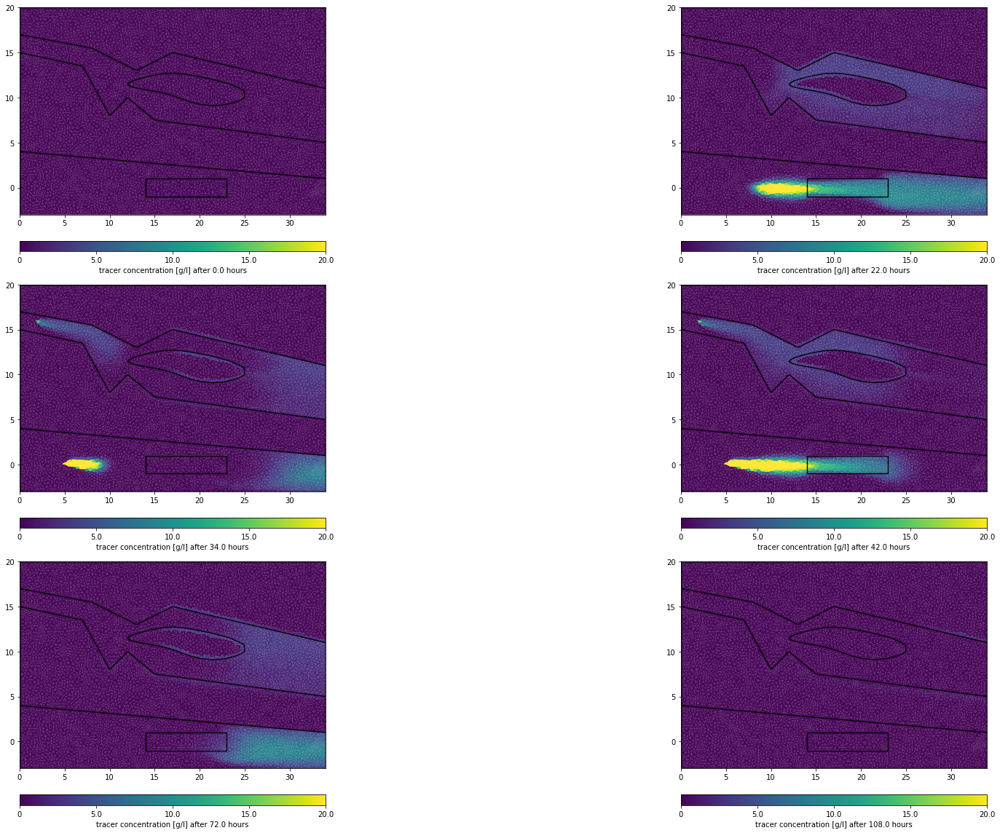

In [117]:
#plot the process is different time-steps:
frames = [0,round(steps*0.18),round(steps*0.28),round(steps*0.35),round(steps*0.6),round(steps*0.9)]
fig, axes = plt.subplots(3,2,figsize =(32,16))

pg.show(mesh, c[frames[0]], cMin = 0, cMax = 20, label = "tracer concentration [g/l] after {} hours".format(round(frames[0]*del_t_h,0)),
        ax=axes[0,0], hold=True)
pg.show(mesh, c[frames[1]], cMin = 0, cMax = 20, label = "tracer concentration [g/l] after {} hours".format(round(frames[1]*del_t_h,0)), 
        ax=axes[0,1], hold=True)
pg.show(mesh, c[frames[2]], cMin = 0, cMax = 20, label = "tracer concentration [g/l] after {} hours".format(round(frames[2]*del_t_h,0)), 
        ax=axes[1,0], hold=True)
pg.show(mesh, c[frames[3]], cMin = 0, cMax = 20, label = "tracer concentration [g/l] after {} hours".format(round(frames[3]*del_t_h,0)),
        ax=axes[1,1], hold=True)
pg.show(mesh, c[frames[4]], cMin = 0, cMax = 20, label = "tracer concentration [g/l] after {} hours".format(round(frames[4]*del_t_h,0)), 
        ax=axes[2,0], hold=True)
pg.show(mesh, c[frames[5]], cMin = 0, cMax = 20, label = "tracer concentration [g/l] after {} hours".format(round(frames[5]*del_t_h,0)), 
        ax=axes[2,1], hold=True)
fig.tight_layout()

(<AxesSubplot:>, <matplotlib.colorbar.Colorbar at 0x121f1d07e88>)

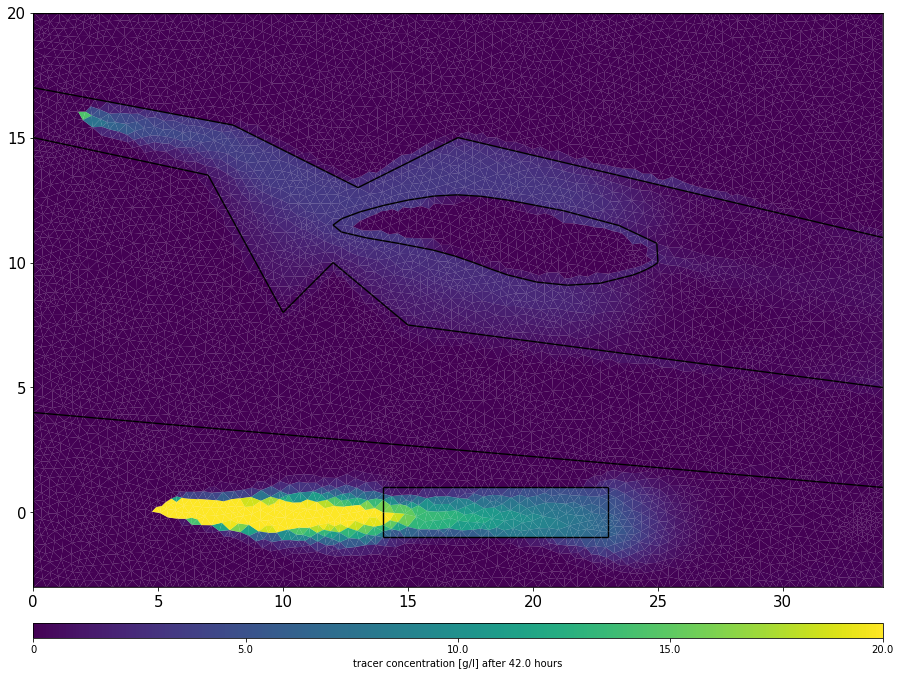

In [134]:
# single plot:
fig, axes = plt.subplots(figsize =(17,11.5))
axes.tick_params(labelsize=15)
pg.show(mesh, c[frames[3]], cMin = 0, cMax = 20, label = "tracer concentration [g/l] after {} hours".format(round(frames[3]*del_t_h,0)),
        ax=axes, hold=True)

In [119]:
from IPython.display import HTML, clear_output
import matplotlib.animation as animation
from pygimli.viewer.mpl import drawModel
from pygimli.viewer.mpl import createColorBar
from pygimli.viewer.mpl import setMappableData

In [161]:
%%capture
# Create animation
fig, ax = plt.subplots()
time_text = ax.text(0.02, 0.9, '', color='white', fontsize=14, transform=ax.transAxes)
# limits of the concentration:
plot_cfg = {
    "cMin": 0,
    "cMax": 30,
    "logScale": False
}

gci = drawModel(ax, mesh, c[0], **plot_cfg) #returns model that can be animated
createColorBar(gci, label="concentration [$g/l$]", pad=0.55)

#create animation frames:
def animate(i):
    time_text.set_text('time = {} hours'.format(round(i*del_t_h,2)))
    setMappableData(gci, c[i], **plot_cfg)

# interval is time between frames in ms
anim = animation.FuncAnimation(fig, animate, frames=len(c),
                               interval=40, repeat=False)

In [162]:
# create animation:
HTML(anim.to_jshtml())

C:\Users\michi\Anaconda3\envs\pg\lib\site-packages\pygimli\viewer\mpl\colorbar.py:434: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  mappable.get_cmap().set_bad([1.0, 1.0, 1.0, 0.0])
24/10/20 - 21:18:33 - matplotlib.animation - WARNING - Animation size has reached 21033726 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [177]:
# animation can be saved as mp4:
anim.save('images/tracer_injection_anim.mp4')

# 4. el. conductivity and resistivity

In [164]:
# electric conductivity
sigma_0=0.1 # mS/cm
sigma_0=0.1*sigma_0 # S/m
sigma_W = 0.1*c+sigma_0 # S/m

In [2]:
# plot el. conductivity:
fig,axes = plt.subplots(3,1,figsize =(40,20))
# fluid conductivity:
pg.show(mesh, sigma_W[frames[2]], cMin = 0, cMax = 20, label = "el. fluid conductivity [S/m] after {} hours".format(round(frames[2]*del_t_h,2)), cMap="BuGn", ax=axes[0], hold=True)
pg.show(mesh, sigma_W[frames[3]], cMin = 0, cMax = 20, label = "el. fluid conductivity [S/m] after {} hours".format(round(frames[3]*del_t_h,2)), cMap="BuGn", ax=axes[1], hold=True)
pg.show(mesh, sigma_W[frames[4]], cMin = 0, cMax = 20, label = "el. fluid conductivity [S/m] after {} hours".format(round(frames[4]*del_t_h,2)), cMap="BuGn", ax=axes[2], hold=True)
fig.tight_layout()

NameError: name 'plt' is not defined

# 5: Transform fluid conductivity into bulk resistivity of the rock

In [166]:
# Archie's equation:
a=1
m=2
n=2
S=1
rho_b = a*(1/sigma_W)*(por**(-m))*(S**(-n))

In [1]:
ertScheme = ert.createERTData(pg.utils.grange(0, 34, dx=1), schemeName='dd')

meshERT = mt.createParaMesh(ertScheme, quality=34.3, paraMaxCellSize=0.2,
                            boundaryMaxCellSize=50, smooth=[1, 2])
pg.show(meshERT)

NameError: name 'ert' is not defined

In [181]:
# Select 10 time frame to simulate ERT data
timesERT = pg.IVector(np.floor(np.linspace(0, len(c) - 1, 10)))

# Create conductivity of fluid for salt concentration $c$
sigmaFluid = c[timesERT] * 0.1 + 0.01

# Calculate bulk resistivity based on Archie's Law
resBulk = pet.resistivityArchie(rFluid=1. / sigmaFluid, porosity=por, m=m,
                                  mesh=mesh, meshI=meshERT, fill=1)

# apply background resistivity model
rho0 = np.zeros(meshERT.cellCount()) + 1000.
for cel in meshERT.cells():
    if cel.center()[1] < -8:
        rho0[cel.id()] = 150.
    elif cel.center()[1] < -2:
        rho0[cel.id()] = 500.
resis = pg.Matrix(resBulk)
for i, rbI in enumerate(resBulk):
    resis[i] = 1. / ((1. / rbI) + 1. / rho0)

In [182]:
ERT = ERTManager(verbose=False)
# Run  simulation for  the apparent resistivities
rhoa = ERT.simulate(meshERT, res=resis, scheme=ertScheme,
                    returnArray=True, verbose=False)

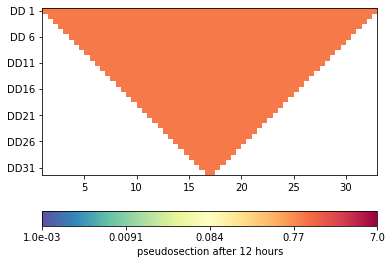

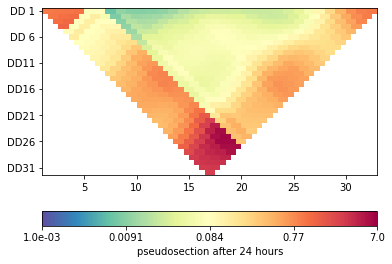

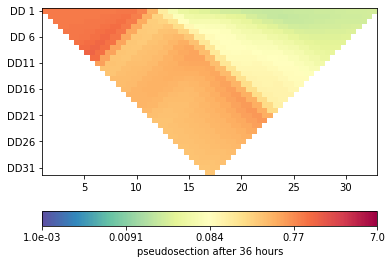

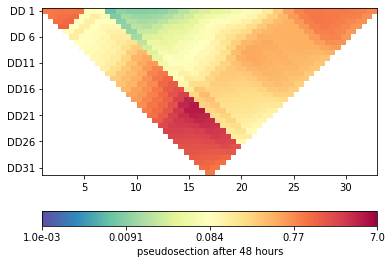

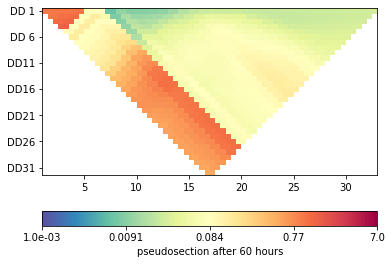

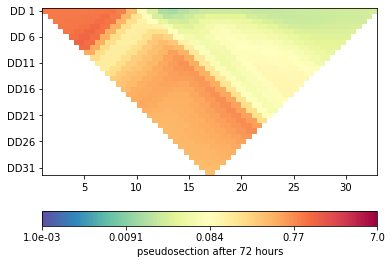

In [184]:
for i in range(6):
    ERT.showData(ertScheme, vals=rhoa[i]/rhoa[0], cMin=1e-3, cMax=7,
                 label = "pseudosection after {} hours".format(round((timeperiod/3600)*((i+1)/10)),1))

In [178]:
#fig.savefig('images/pseudosection_subplots.png', bbox_inches='tight')